## EXP2 : Reduced vs unreduced on daily S&P500
### Declare common params

In [1]:
base_path="../eit_basic_dual_unreduced_experiments/exp_2" #Don't add '/' at start and end
T=880 #Training time period
C=10000 #Capital available
file="daily9" #Index_file
#m=8 #Inital Size of Kernel
lbuck=20 #Size Of Buckets
#pho=0.1 #Transaction Cost Proportion
lamda=1/(100*C) # lower_bound for capital invested in jth stock
#nuh=0.3  # upper_bound
#xii=1.2 # Limit for Tracking Error
#k=20 #Cardinality constraint for stocks in portfolio
p=3 #If stock not selected in optimal soln in last p iters then it is to be dropped from kernel
f=12
w_return=100
w_risk=1000
w_risk_down=1.2
#cj,cb are declared in script

In [2]:
import sys
sys.path.insert(0,"..") #Add root folder to sys path

from eit_basic_experiment import TestEitBasic
from eit_dual_exp import TestEitDual

import time
from tqdm.notebook import tqdm
from IPython.utils import io
from joblib import Parallel, delayed
import pandas as pd

### Generate instances of test objects for various combinations of params

In [3]:
# !rm -r $base_path

In [3]:
path_pattern=base_path+"/{}/file={},pho={},xii={},k={},m={},lbuck={},p={},nuh={}"

In [4]:
%%time
basic_instances=[]
dual_instances=[]
for file in ["daily9"]:
    for pho in [0.2,0.3]:
        for xii in [1.1,1.2]:
            for k in [100,120,140]:
                for m in [70,90]:
                    for nuh in [0.3,0.35,0.4]:
                        output_basic=path_pattern.format("basic",file,pho,xii,k,m,lbuck,p,nuh)
                        #Create object for EIT-basic
                        test_eit_basic=TestEitBasic(output=output_basic,T=T,C=C,file=file,m=m,lbuck=lbuck,\
                                            pho=pho,lamda=lamda,nuh=nuh,xii=xii,k=k,p=p,f=f)
                        basic_instances.append(test_eit_basic)
                        #Create object for EIT-dual
                        output_dual=path_pattern.format("dual",file,pho,xii,k,m,lbuck,p,nuh)
                        test_eit_dual=TestEitDual(output=output_dual,T=T,C=C,file=file,m=m,lbuck=lbuck,pho=pho,\
                                                  lamda=lamda,nuh=nuh,xii=xii,k=k,p=p,f=f,w_risk=w_risk,\
                                                  w_return=w_return,w_risk_down=w_risk_down)
                        dual_instances.append(test_eit_dual)

CPU times: user 1.8 ms, sys: 191 µs, total: 1.99 ms
Wall time: 1.95 ms


### Run the EIT problems with threading

In [5]:
def parallel_func(eit_object):
    params=eit_object.give_params()
    step_dict={}
    try:
        result_df=eit_object.run_experiment(from_root=False,verbose=False);
        result_df["z_linear"]=eit_object.objective_linear
        #result_dict.update(step_dict)
    except Exception as e:
        print("Error for params",params)
        result_df=None
    step_dict[params]=result_df   
    return (step_dict)

In [7]:
%%time
#test_2={}
basic_outputs=Parallel(verbose = 2,n_jobs  = -1\
            )(delayed( parallel_func )(run) for run in tqdm(basic_instances))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed: 127.5min



CPU times: user 1.06 s, sys: 441 ms, total: 1.5 s
Wall time: 5h 8min 13s


[Parallel(n_jobs=-1)]: Done  72 out of  72 | elapsed: 308.2min finished


In [ ]:
%%time
#test_2={}
dual_outputs=Parallel(verbose = 2,n_jobs  = -1\
            )(delayed( parallel_func )(run) for run in tqdm(dual_instances))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


### Aggregate results

In [8]:
def make_result(parallel_output):
    final_result=pd.DataFrame()
    for output_i in parallel_output:
        params,result_df=next(iter(output_i.items()))
        param_part=pd.DataFrame([params])
        if result_df is None:
            res_part=pd.DataFrame()
        else:
            res_part=pd.DataFrame([result_df.loc[result_df.z_value.idxmax()]])
        temp=pd.concat([param_part,res_part.reset_index()],axis=1,ignore_index=False)
        final_result=final_result.append(temp)
    return (final_result)

In [9]:
basic_result=make_result(basic_outputs)
basic_result.to_csv(base_path+"/basic_results_exp_1.csv")

In [ ]:
dual_result=make_result(dual_outputs)
dual_result.to_csv(base_path+"/dual_results_exp_1.csv")

### Compare results

In [ ]:
basic_result.columns

In [ ]:
print("Basic Infeasible for % of param combs={:.2f}",basic_result.z_value.isnull().mean())
print("Dual Infeasible for % of param combs={:.2f}",dual_result.z_value.isnull().mean())

In [ ]:
basic_result["return_pu_risk_sample"]=basic_result["in_excess_return"]/basic_result["in_tr_err"].abs()
basic_result["return_pu_risk_oot"]=basic_result["out_excess_return"]/basic_result["out_tr_err"].abs()

dual_result["return_pu_risk_sample"]=dual_result["in_excess_return"]/dual_result["in_tr_err"].abs()
dual_result["return_pu_risk_oot"]=dual_result["out_excess_return"]/dual_result["out_tr_err"].abs()

In [ ]:
basic_k_pho_nuh=basic_result.groupby(["k","pho","nuh"])[["return_pu_risk_sample","return_pu_risk_oot"]].mean()
dual_k_pho_nuh=dual_result.groupby(["k","pho","nuh"])[["return_pu_risk_sample","return_pu_risk_oot"]].mean()

In [ ]:
from IPython.display import display_html 

In [ ]:
df1_styler = basic_k_pho_nuh.style.set_table_attributes("style='display:inline'").set_caption('EIT Basic')
df2_styler = dual_k_pho_nuh.style.set_table_attributes("style='display:inline'").set_caption('EIT Dual')

display_html(df1_styler._repr_html_()+df2_styler._repr_html_(), raw=True)

In [ ]:
combined_k_pho_nuh=basic_k_pho_nuh.merge(dual_k_pho_nuh,on=["k","pho","nuh"],suffixes=("_basic","_dual"))

In [ ]:
((combined_k_pho_nuh["return_pu_risk_sample_dual"]>combined_k_pho_nuh["return_pu_risk_sample_basic"])).mean()

In [ ]:
combined_k_pho_nuh.columns

In [ ]:
((combined_k_pho_nuh["return_pu_risk_oot_dual"]>combined_k_pho_nuh["return_pu_risk_oot_basic"])).mean()

In [ ]:
combined_k_pho_nuh.to_csv(base_path+"/combined_k_pho_nuh.csv")

Comparision metric = Return/Risk, where:
\\[Return = Excess Return  
          = Average\ over\ time[{\$(return\ on\ portfolio)_t - \$(return\ on\ index)}_t]\\]
                 
\\[Risk = Tracking Error
        = Average\ over\ time[|$(index\ value)_t - $(portfolio\ value)_t|]\\]

Or,
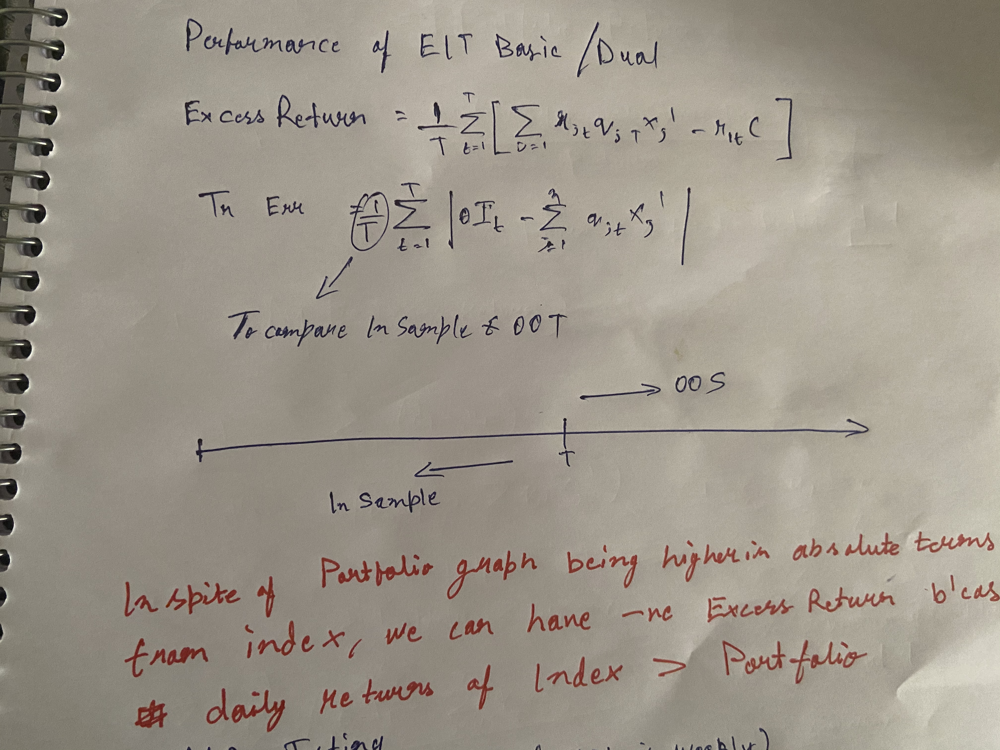

In [ ]:
combined_k_pho_nuh